In [1]:
# Hands-on Image Processing with Python
# Chapter 5: Image Enhancements using Derivatives
# Author: Sandipan Dey
# Import libraries haha
%matplotlib inline
import numpy as np
from scipy import signal, misc, ndimage
from skimage import filters, feature, img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import Image, ImageFilter
import matplotlib.pylab as pylab

C:\Users\omkar\AppData\Local\Temp\ipykernel_376\3422269691.py:20: RuntimeWarning: divide by zero encountered in divide
  im_dir = np.arctan(im_y / im_x)
C:\Users\omkar\AppData\Local\Temp\ipykernel_376\3422269691.py:20: RuntimeWarning: invalid value encountered in divide
  im_dir = np.arctan(im_y / im_x)


<Figure size 640x480 with 0 Axes>

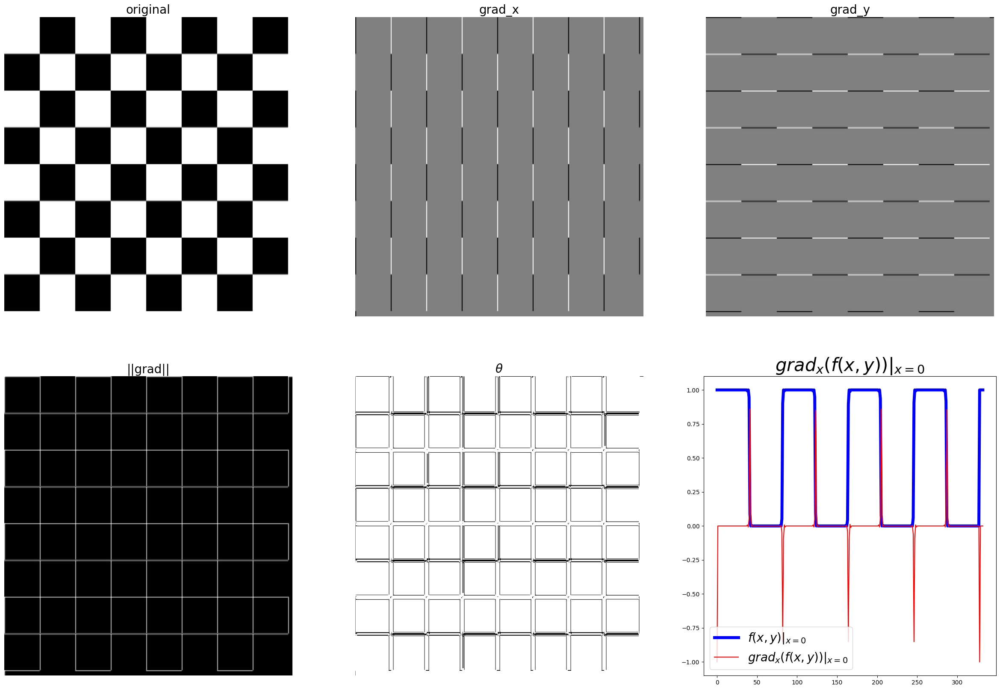

In [2]:
from skimage.color import rgb2gray
from scipy import signal
import matplotlib.pylab as pylab
from skimage.io import imread

def plot_image(image, title):
    pylab.imshow(image, cmap='gray')
    pylab.title(title, size=20)
    pylab.axis('off')

ker_x = [[-1, 1]]
ker_y = [[-1], [1]]

# Load the image and convert it to grayscale
im = rgb2gray(imread("images/chess.png")[:, :, :3])

im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_dir = np.arctan(im_y / im_x)

pylab.gray()
pylab.figure(figsize=(30, 20))
pylab.subplot(231), plot_image(im, 'original')
pylab.subplot(232), plot_image(im_x, 'grad_x')
pylab.subplot(233), plot_image(im_y, 'grad_y')
pylab.subplot(234), plot_image(im_mag, '||grad||')
pylab.subplot(235), plot_image(im_dir, r'$\theta$')

pylab.subplot(236)
pylab.plot(range(im.shape[1]), im[0, :], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
pylab.plot(range(im.shape[1]), im_x[0, :], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
pylab.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
pylab.legend(prop={'size': 20})

pylab.show()


1.0


C:\Users\omkar\AppData\Local\Temp\ipykernel_376\1929681299.py:18: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)
C:\Users\omkar\AppData\Local\Temp\ipykernel_376\1929681299.py:18: RuntimeWarning: invalid value encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

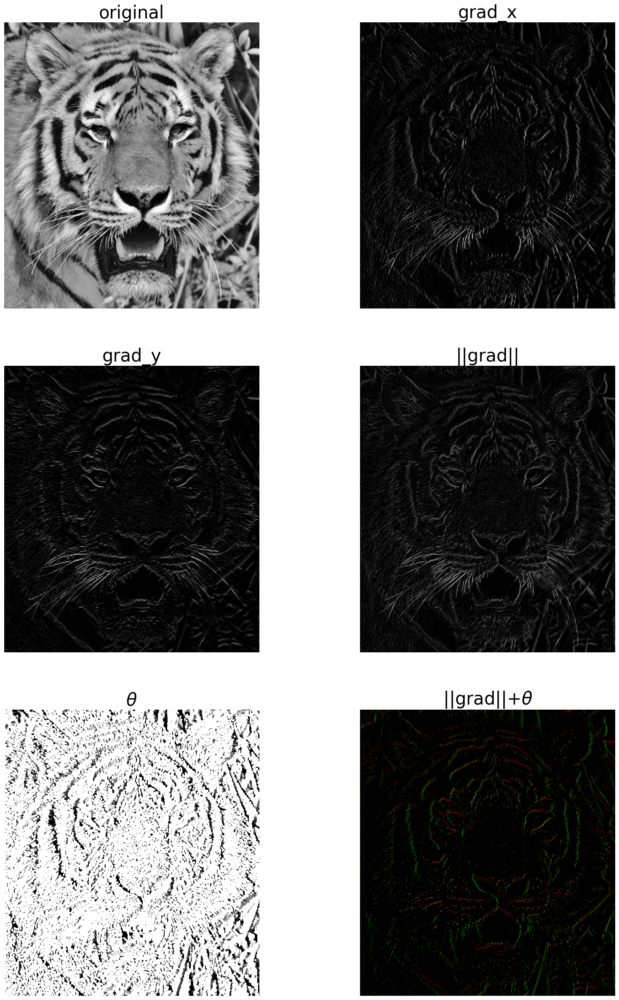

In [3]:
# Displaying the magnitude and the gradient on the same image
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.util import random_noise
from skimage.filters import gaussian
import matplotlib.pylab as plt
from scipy import signal
import numpy as np
ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread("images/tiger3.jpg"))
#im = random_noise(im, var=sigma**2)
#im = gaussian(im, sigma=0.25)
print(np.max(im))
im_x = np.clip(signal.convolve2d(im, ker_x, mode='same'),0,1)
im_y = np.clip(signal.convolve2d(im, ker_y, mode='same'),0,1)
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)
plt.gray()
plt.figure(figsize=(20,30))
plt.subplot(321)
plt.imshow(im)
plt.title('original', size=30)
plt.axis('off')
plt.subplot(322)
plt.imshow(im_x)
plt.title('grad_x', size=30)
plt.axis('off')
plt.subplot(323)
plt.imshow(im_y)
plt.title('grad_y', size=30)
plt.axis('off')
plt.subplot(324)
plt.imshow(im_mag)
plt.title('||grad||', size=30)
plt.axis('off')
plt.subplot(325)
plt.imshow(im_ang)
plt.title(r'$\theta$', size=30)
plt.axis('off')
plt.subplot(326)
im = np.zeros((im.shape[0],im.shape[1],3))
im[...,0] = im_mag*np.sin(im_ang)
im[...,1] = im_mag*np.cos(im_ang)
plt.imshow(im)
plt.title(r'||grad||+$\theta$', size=30)
plt.axis('off')
plt.show()

<Figure size 640x480 with 0 Axes>

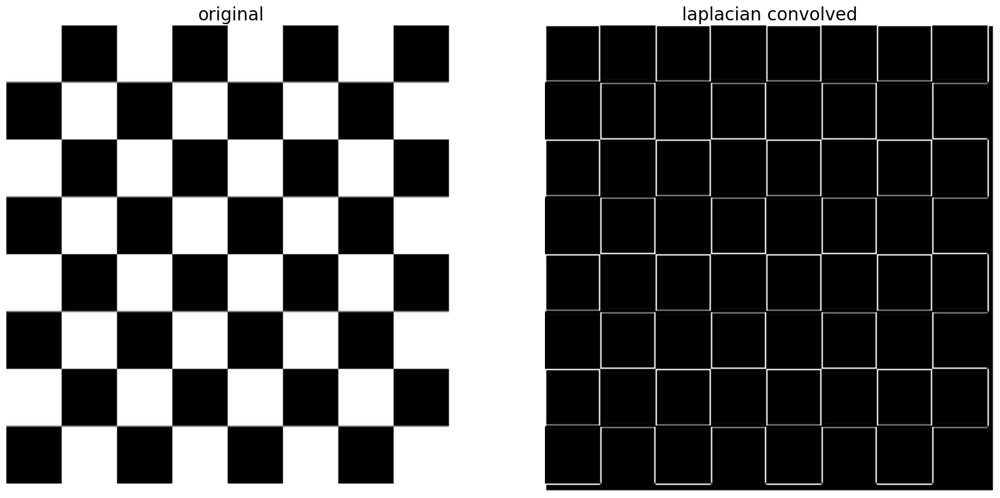

In [4]:
# Laplacian
from skimage.color import rgb2gray
from scipy import signal
import matplotlib.pylab as pylab
from skimage.io import imread

def plot_image(image, title):
    pylab.imshow(image, cmap='gray')
    pylab.title(title, size=20)
    pylab.axis('off')

ker_laplacian = [[0, -1, 0], [-1, 4, -1], [0, -1, 0]]

# Load the image with RGBA channels
im = imread("images/chess.png")

# Convert the image to grayscale while ignoring the alpha channel
im_gray = rgb2gray(im[:, :, :3])

im1 = np.clip(signal.convolve2d(im_gray, ker_laplacian, mode='same'), 0, 1)

pylab.gray()
pylab.figure(figsize=(20, 10))
pylab.subplot(121), plot_image(im_gray, 'original')
pylab.subplot(122), plot_image(im1, 'laplacian convolved')
pylab.show()


1.0000000000000004


C:\Users\omkar\AppData\Local\Temp\ipykernel_376\2292624603.py:33: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)
C:\Users\omkar\AppData\Local\Temp\ipykernel_376\2292624603.py:33: RuntimeWarning: invalid value encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

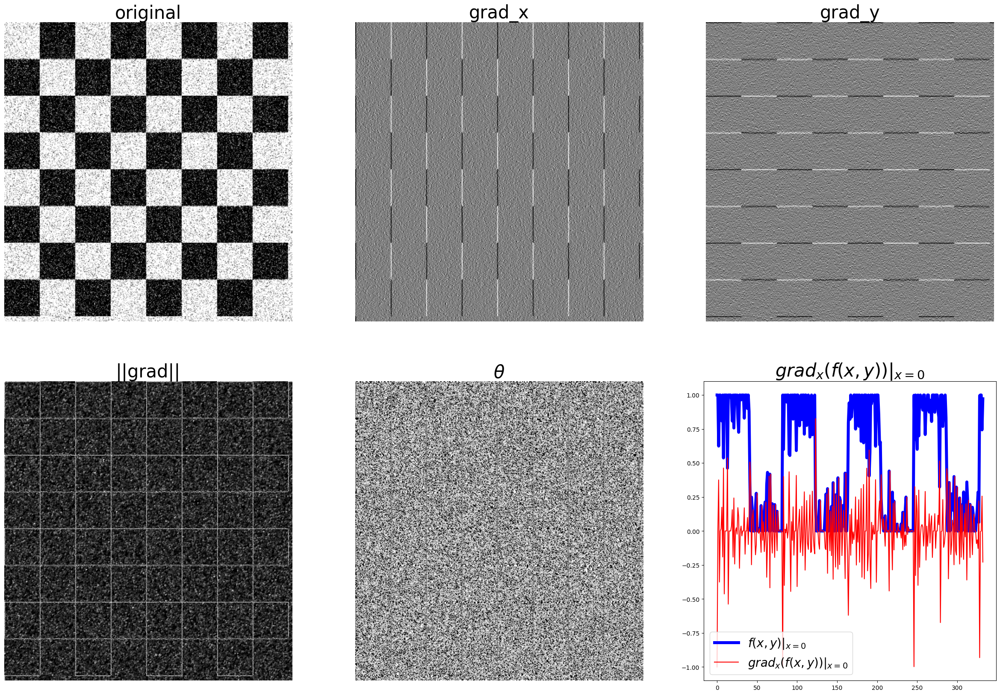

In [5]:
import numpy as np
import matplotlib.pylab as plt
from skimage.filters import gaussian
from scipy import signal
from skimage.io import imread
from skimage.color import rgba2rgb, rgb2gray
from skimage.util import random_noise

ker_x = [[-1, 1]]
ker_y = [[-1], [1]]

# Read the image with RGBA channels
im_rgba = imread("images/chess.png")

# Convert to RGB, preserving the alpha channel
im_rgb = rgba2rgb(im_rgba)

# Convert the RGB image to grayscale
im = rgb2gray(im_rgb)

sigma = 0.25
sign = np.random.random(im.shape)
sign[sign <= 0.5] = -1
sign[sign > 0.5] = 1

im = random_noise(im, var=sigma**2)
im = gaussian(im, sigma=0.25)
print(np.max(im))

im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)

plt.gray()
plt.figure(figsize=(30, 20))
plt.subplot(231)
plt.imshow(im)
plt.title('original', size=30)
plt.axis('off')
plt.subplot(232)
plt.imshow(im_x)
plt.title('grad_x', size=30)
plt.axis('off')
plt.subplot(233)
plt.imshow(im_y)
plt.title('grad_y', size=30)
plt.axis('off')
plt.subplot(234)
plt.imshow(im_mag)
plt.title('||grad||', size=30)
plt.axis('off')
plt.subplot(235)
plt.imshow(im_ang)
plt.title(r'$\theta$', size=30)
plt.axis('off')
plt.subplot(236)
plt.plot(range(im.shape[1]), im[0, :], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
plt.plot(range(im.shape[1]), im_x[0, :], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
plt.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
plt.legend(prop={'size': 20})
plt.show()


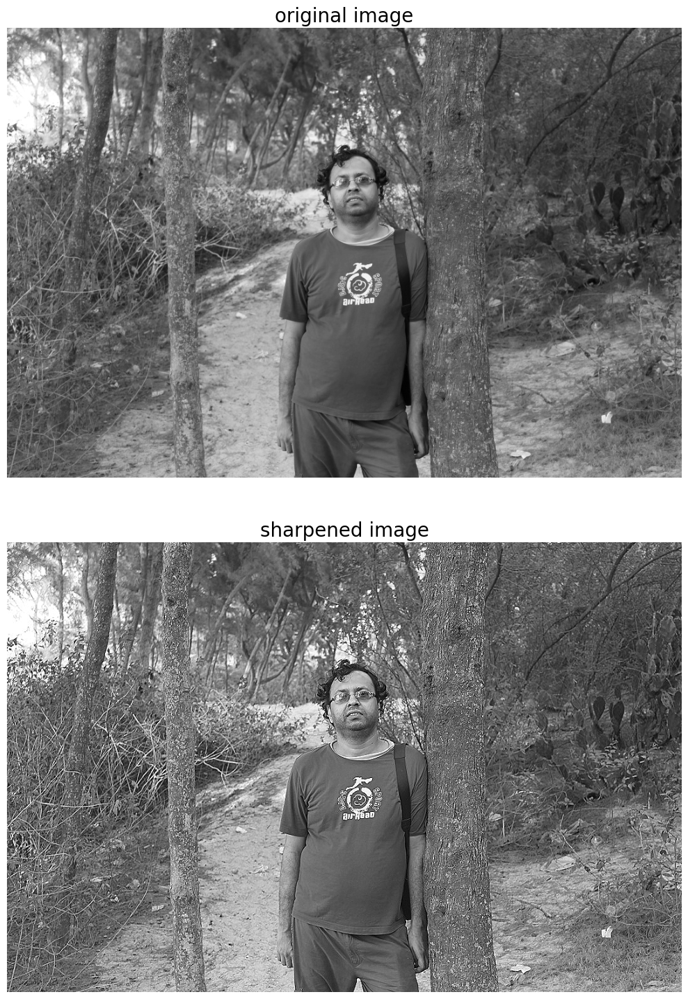

In [6]:
# Sharpening with Laplacian
from skimage.filters import laplace
im = rgb2gray(imread("images/me8.JPG"))
im1 = np.clip(laplace(im) + im, 0, 1)
pylab.figure(figsize=(10,15))
pylab.subplot(211), plot_image(im, 'original image')
pylab.subplot(212), plot_image(im1, 'sharpened image')
pylab.tight_layout()
pylab.show()

<Figure size 640x480 with 0 Axes>

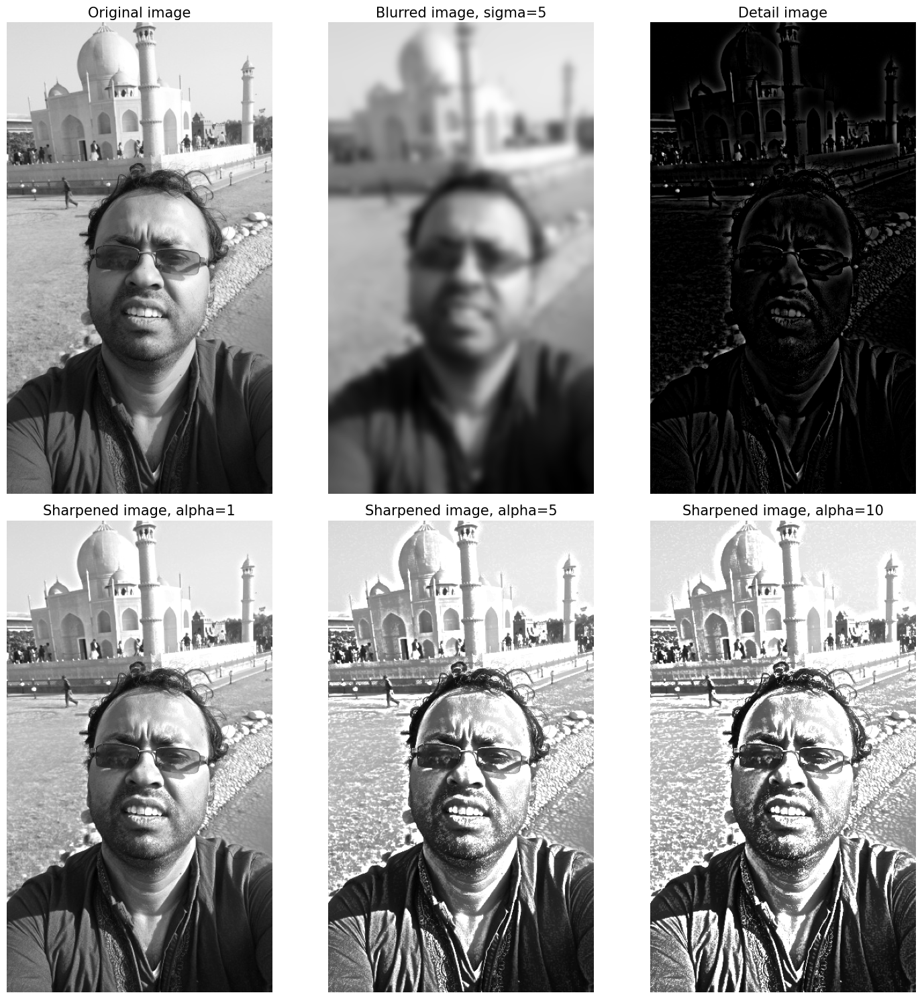

In [7]:
# Unsharp masking
import numpy as np
import matplotlib.pylab as pylab
from scipy import ndimage
from skimage import img_as_float
from skimage.io import imread
from skimage.color import rgb2gray

def rgb2gray(im):
    return np.clip(0.2989 * im[..., 0] + 0.5870 * im[..., 1] + 0.1140 * im[..., 2], 0, 1)

# Load the image using matplotlib.pyplot.imread
im = rgb2gray(img_as_float(imread("images/me4.jpg")))

im_blurred = ndimage.gaussian_filter(im, 5)
im_detail = np.clip(im - im_blurred, 0, 1)

pylab.gray()
fig, axes = pylab.subplots(nrows=2, ncols=3, sharex=True, sharey=True, figsize=(15, 15))
axes = axes.ravel()

axes[0].set_title('Original image', size=15)
axes[0].imshow(im)

axes[1].set_title('Blurred image, sigma=5', size=15)
axes[1].imshow(im_blurred)

axes[2].set_title('Detail image', size=15)
axes[2].imshow(im_detail)

alpha = [1, 5, 10]

for i in range(3):
    im_sharp = np.clip(im + alpha[i] * im_detail, 0, 1)
    axes[3 + i].imshow(im_sharp)
    axes[3 + i].set_title('Sharpened image, alpha=' + str(alpha[i]), size=15)

for ax in axes:
    ax.axis('off')

fig.tight_layout()
pylab.show()


<Figure size 640x480 with 0 Axes>

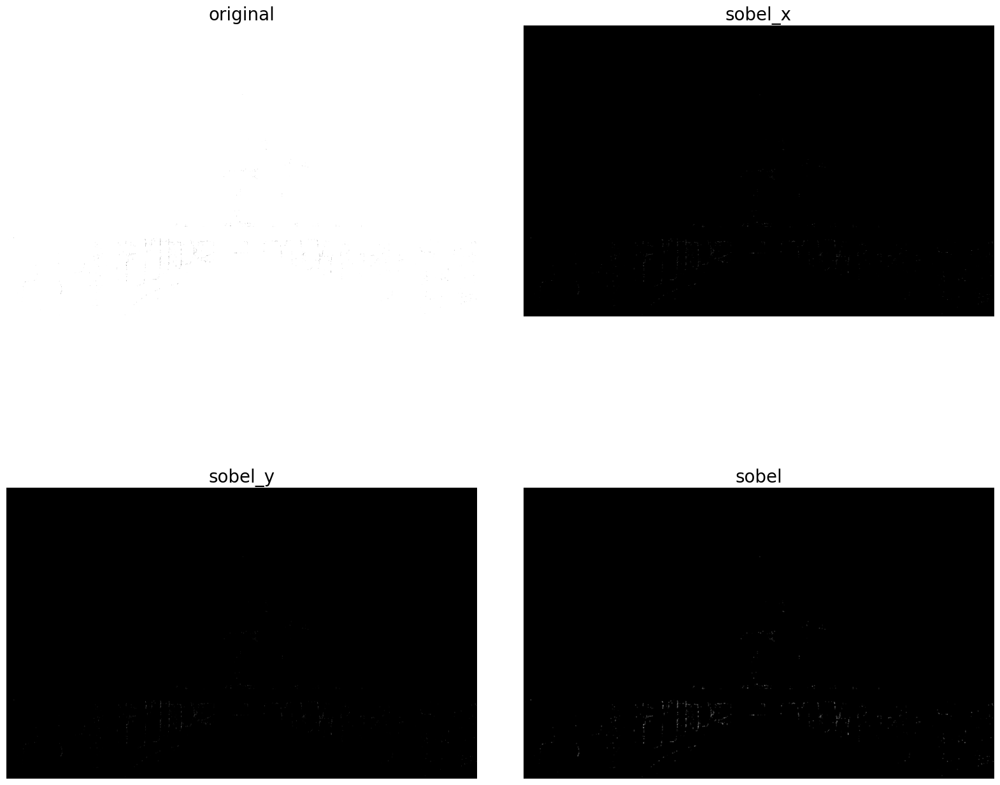

In [9]:
# Sobel edge detector with scikit-image
im = rgb2gray(imread("images/tajmahal.jpg")) # RGB image to gray scale
pylab.gray()
pylab.figure(figsize=(20,18))
pylab.subplot(2,2,1)
plot_image(im, 'original')
pylab.subplot(2,2,2)
edges_x = filters.sobel_h(im)
plot_image(np.clip(edges_x,0,1), 'sobel_x')
pylab.subplot(2,2,3)
edges_y = filters.sobel_v(im)
plot_image(np.clip(edges_y,0,1), 'sobel_y')
pylab.subplot(2,2,4)
edges = filters.sobel(im)
plot_image(np.clip(edges,0,1), 'sobel')
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

<Figure size 640x480 with 0 Axes>

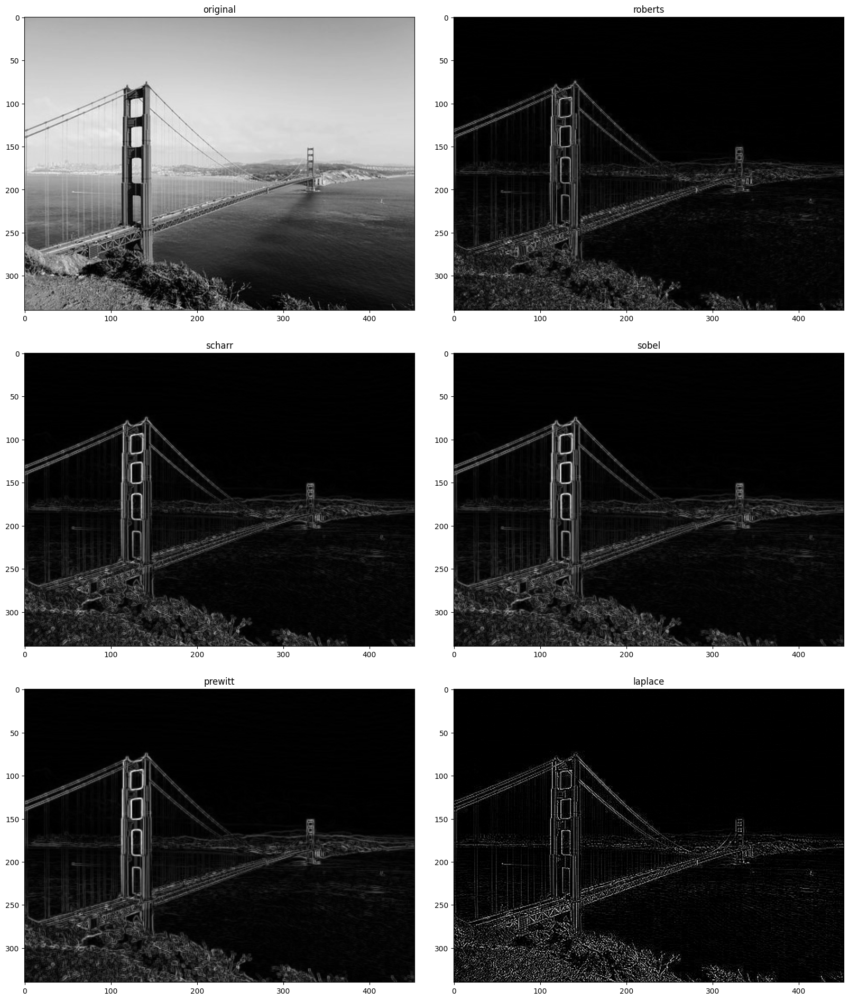

In [10]:
# Different edge detectors with scikit-image – Prewitt, Roberts, Sobel, Scharr, and Laplace
import numpy as np
import matplotlib.pylab as pylab
from scipy import ndimage
from skimage import img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from skimage import filters

im = rgb2gray(imread("images/goldengate.jpg")) # RGB image to grayscale
pylab.gray()
pylab.figure(figsize=(20, 24))
pylab.subplot(3, 2, 1)
pylab.imshow(im, cmap='gray')
pylab.title('original')

edges = filters.roberts(im)
pylab.subplot(3, 2, 2)
pylab.imshow(edges, cmap='gray')
pylab.title('roberts')

edges = filters.scharr(im)
pylab.subplot(3, 2, 3)
pylab.imshow(edges, cmap='gray')
pylab.title('scharr')

edges = filters.sobel(im)
pylab.subplot(3, 2, 4)
pylab.imshow(edges, cmap='gray')
pylab.title('sobel')

edges = filters.prewitt(im)
pylab.subplot(3, 2, 5)
pylab.imshow(edges, cmap='gray')
pylab.title('prewitt')

edges = np.clip(filters.laplace(im), 0, 1)
pylab.subplot(3, 2, 6)
pylab.imshow(edges, cmap='gray')
pylab.title('laplace')

pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()


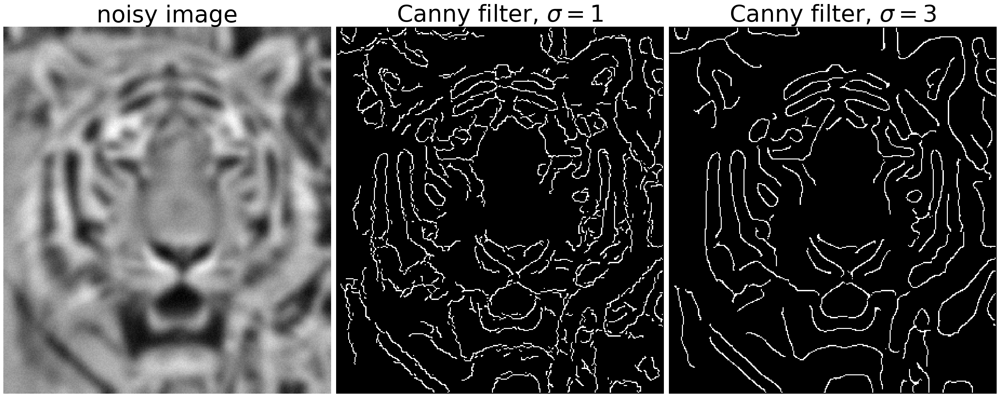

In [11]:
# The Canny edge detector with scikit-image
import numpy as np
import matplotlib.pylab as pylab
from scipy import ndimage
from skimage import img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.feature import canny  # Import the canny function

im = rgb2gray(imread("images/tiger3.jpg"))
im = ndimage.gaussian_filter(im, 4)
im += 0.05 * np.random.random(im.shape)

edges1 = canny(im)  # Use canny function from skimage.feature
edges2 = canny(im, sigma=2)  # You can specify the sigma value

fig, (axes1, axes2, axes3) = pylab.subplots(nrows=1, ncols=3, figsize=(30, 12), sharex=True, sharey=True)
axes1.imshow(im, cmap=pylab.cm.gray)
axes1.axis('off')
axes1.set_title('noisy image', fontsize=50)
axes2.imshow(edges1, cmap=pylab.cm.gray)
axes2.axis('off')
axes2.set_title('Canny filter, $\sigma=1$', fontsize=50)
axes3.imshow(edges2, cmap=pylab.cm.gray)
axes3.axis('off')
axes3.set_title('Canny filter, $\sigma=3$', fontsize=50)

fig.tight_layout()
pylab.show()



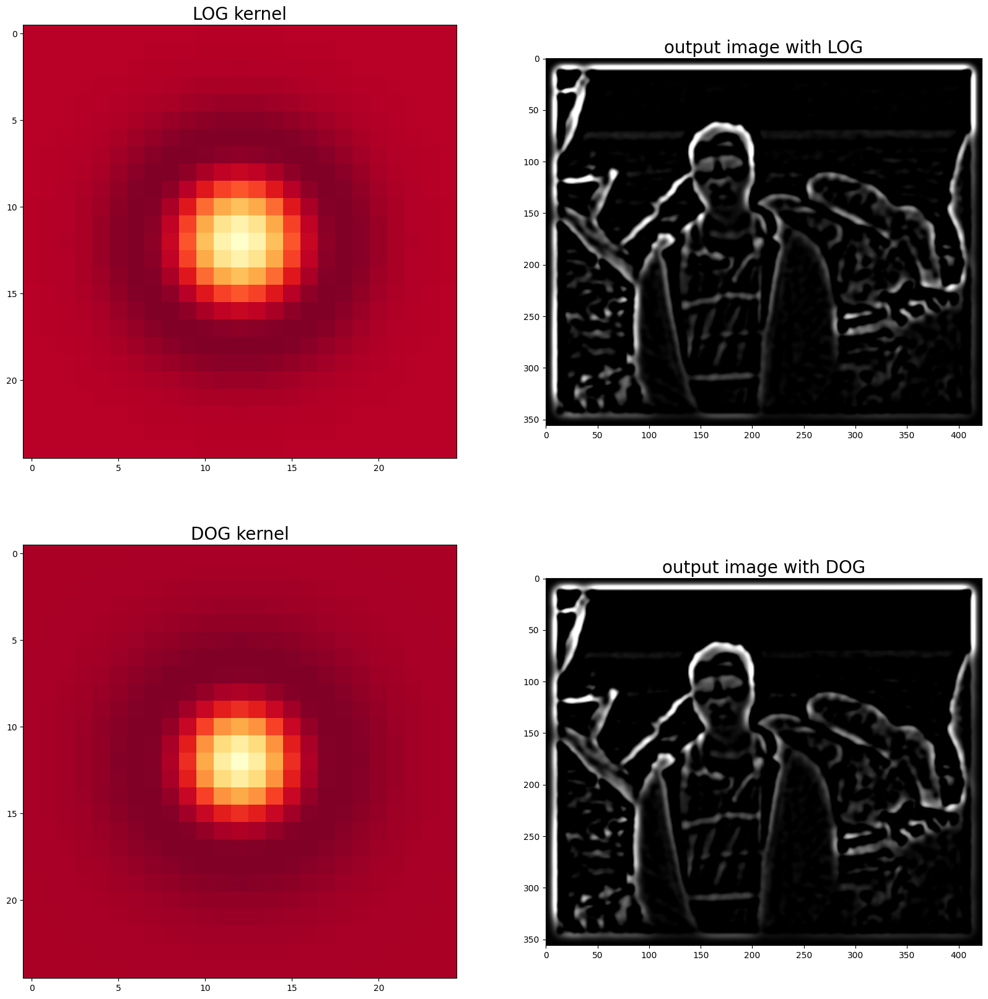

In [12]:
# The LoG and DoG filters
from scipy.signal import convolve2d
from skimage.io import imread
from skimage.color import rgb2gray
import numpy as np
import matplotlib.pylab as pylab

def plot_kernel(kernel, s, name):
    pylab.imshow(kernel, cmap='YlOrRd')

def LOG(k=12, s=3):
    n = 2*k+1  # size of the kernel
    kernel = np.zeros((n,n))
    for i in range(n):
        for j in range(n):
            kernel[i,j] = -(1-((i-k)**2+(j-k)**2)/(2.*s**2))*np.exp(-((i-k)**2+(j-k)**2)/(2.*s**2))/(np.pi*s**4)
    kernel = np.round(kernel / np.sqrt((kernel**2).sum()), 3)
    return kernel

def DOG(k=12, s=3):
    n = 2*k+1  # size of the kernel
    s1, s2 = s * np.sqrt(2), s / np.sqrt(2)
    kernel = np.zeros((n,n))
    for i in range(n):
        for j in range(n):
            kernel[i,j] = np.exp(-((i-k)**2+(j-k)**2)/(2.*s1**2))/(2*np.pi*s1**2) - np.exp(-((i-k)**2+(j-k)**2)/(2.*s2**2))/(2*np.pi*s2**2)
    kernel = np.round(kernel / np.sqrt((kernel**2).sum()), 3)
    return kernel

s = 3  # sigma value for LoG
img = rgb2gray(imread("images/me.jpg"))
kernel = LOG()
outimg = convolve2d(img, kernel)
pylab.figure(figsize=(20, 20))
pylab.subplot(221), pylab.title('LOG kernel', size=20), plot_kernel(kernel, s, 'DOG')
pylab.subplot(222), pylab.title('output image with LOG', size=20)
pylab.imshow(np.clip(outimg, 0, 1), cmap='gray')  # clip the pixel values in between 0 and 1
kernel = DOG()
outimg = convolve2d(img, DOG())
pylab.subplot(223), pylab.title('DOG kernel', size=20), plot_kernel(kernel, s, 'DOG')
pylab.subplot(224), pylab.title('output image with DOG', size=20)
pylab.imshow(np.clip(outimg, 0, 1), cmap='gray')
pylab.show()



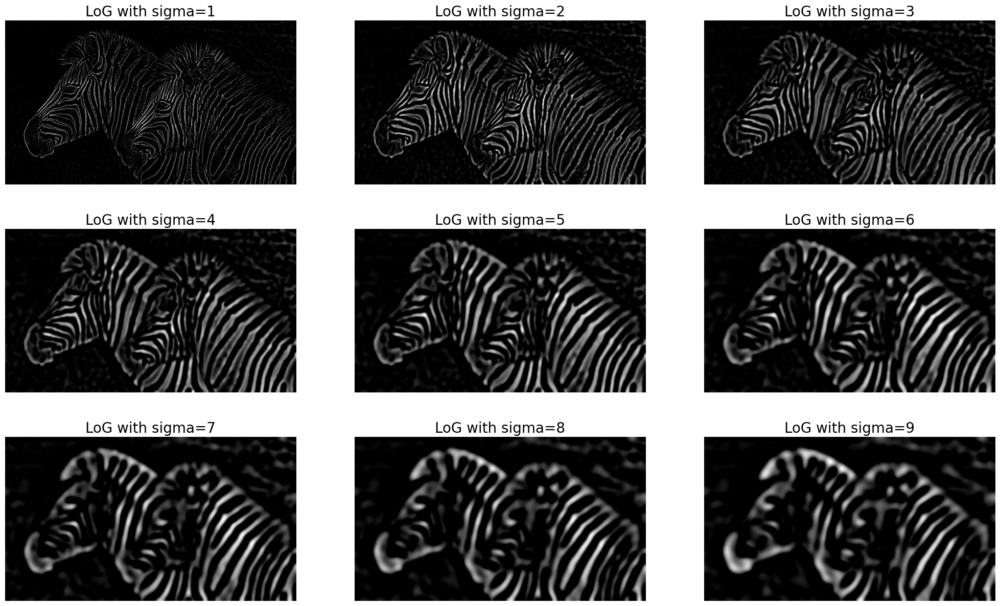

In [13]:
# The LoG filter with the SciPy ndimage module
img = rgb2gray(imread("images/zebras.jpg"))
fig = pylab.figure(figsize=(25,15))
pylab.gray() # show the filtered result in grayscale
for sigma in range(1,10):
    pylab.subplot(3,3,sigma)
    img_log = ndimage.gaussian_laplace(img, sigma=sigma)
    pylab.imshow(np.clip(img_log,0,1)), pylab.axis('off')
    pylab.title('LoG with sigma=' + str(sigma), size=20)
pylab.show()

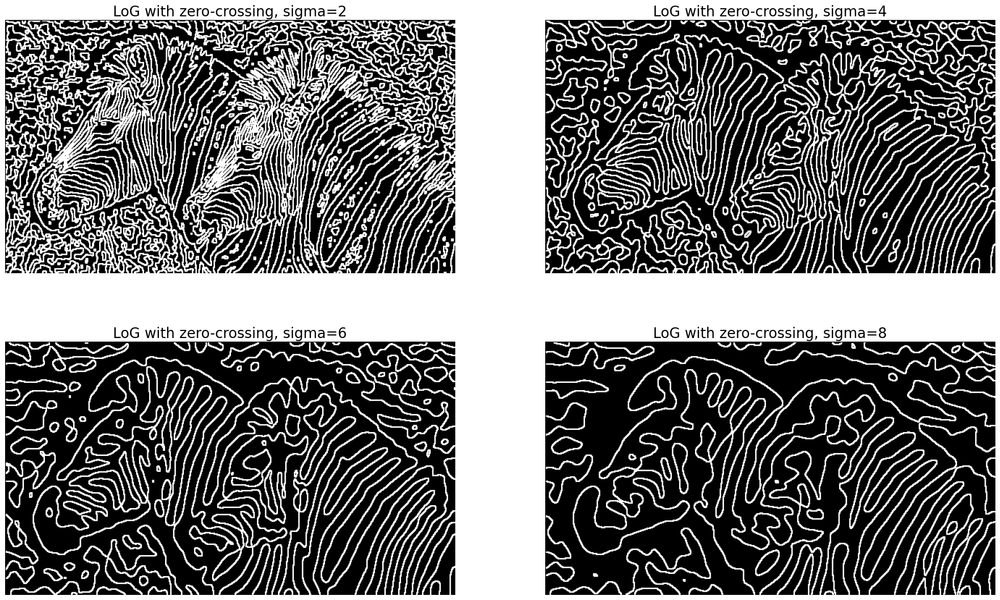

In [14]:
import numpy as np
import matplotlib.pylab as pylab
from scipy import ndimage
from skimage.io import imread
from skimage.color import rgb2gray

def zero_crossing(img):
    # Initialize an output image with zeros
    zero_crossings = np.zeros_like(img, dtype=bool)

    # Define a 3x3 neighborhood
    neighborhood = ndimage.generate_binary_structure(2, 2)

    # Find zero-crossings in the LoG filtered image
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            if img[i, j] == 0:
                continue
            neighborhood_vals = img[i-1:i+2, j-1:j+2]
            if np.any(neighborhood_vals > 0) and np.any(neighborhood_vals < 0):
                zero_crossings[i, j] = True

    return zero_crossings

# Load your image (replace 'your_image_path.jpg' with the actual image path)
# img = rgb2gray(imread('your_image_path.jpg'))
img = rgb2gray(imread("images/zebras.jpg"))
fig = pylab.figure(figsize=(25, 15))
pylab.gray()  # Show the filtered result in grayscale

for sigma in range(2, 10, 2):
    pylab.subplot(2, 2, sigma // 2)
    result = ndimage.gaussian_laplace(img, sigma=sigma)
    zero_crossings_result = zero_crossing(result)
    pylab.imshow(zero_crossings_result, cmap='gray')  # Display zero-crossings
    pylab.axis('off')
    pylab.title('LoG with zero-crossing, sigma=' + str(sigma), size=20)

pylab.show()


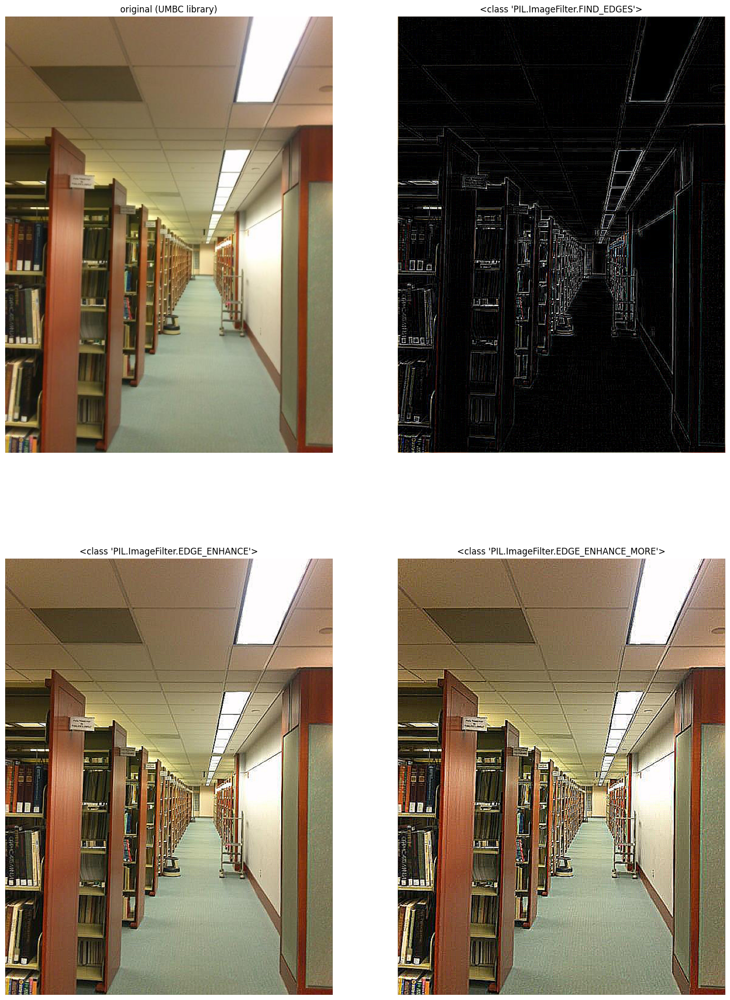

In [15]:
# Finding and enhancing edges with PIL
from PIL import Image, ImageFilter
import matplotlib.pylab as pylab

def plot_image(img, title):
    pylab.imshow(img)
    pylab.axis('off')
    pylab.title(title)

im = Image.open("images/umbc_lib.jpg")
pylab.figure(figsize=(18, 25))
pylab.subplot(2, 2, 1)
plot_image(im, 'original (UMBC library)')

i = 2
for f in (ImageFilter.FIND_EDGES, ImageFilter.EDGE_ENHANCE, ImageFilter.EDGE_ENHANCE_MORE):
    pylab.subplot(2, 2, i)
    im1 = im.filter(f)
    plot_image(im1, str(f))
    i += 1

pylab.show()


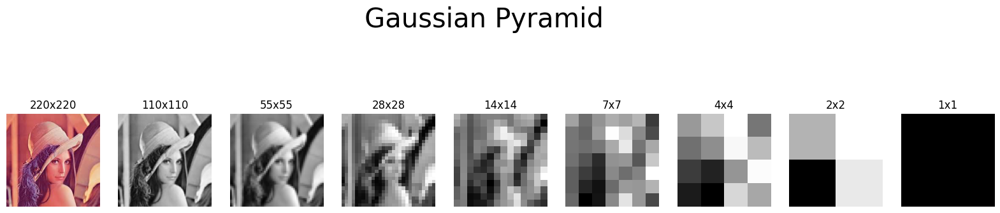

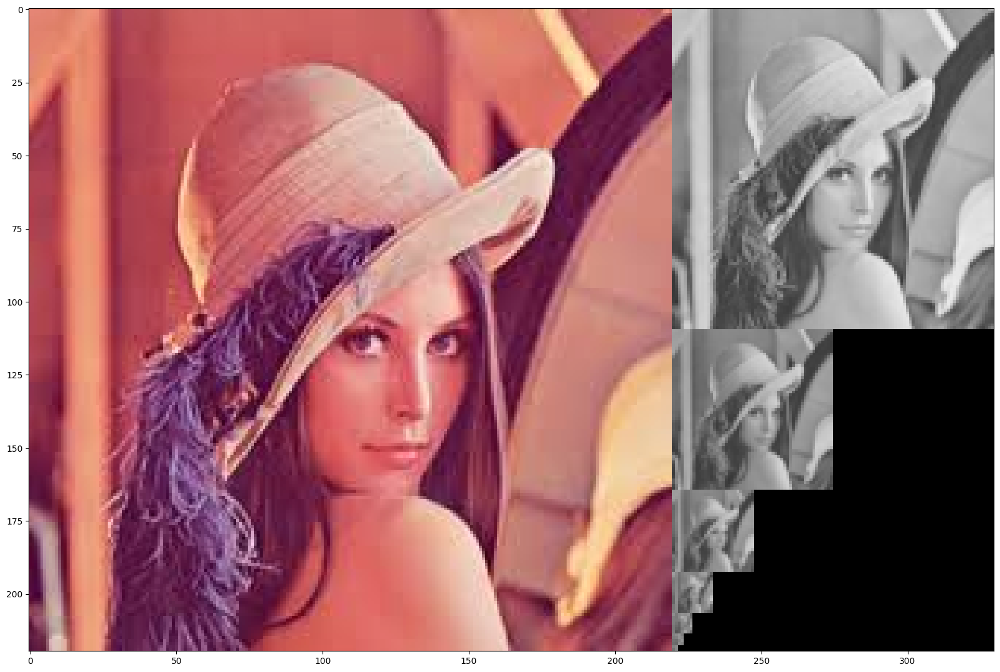

In [16]:
import numpy as np
from skimage.io import imread
from skimage.transform import pyramid_gaussian
import matplotlib.pyplot as plt

image = imread("images/lena.jpg")
nrows, ncols = image.shape[:2]
pyramid = tuple(pyramid_gaussian(image, downscale=2))

plt.figure(figsize=(20, 5))
i, n = 1, len(pyramid)

for p in pyramid:
    if p.shape[-1] == 3:
        # If the image has 3 channels (RGB), display it
        plt.subplot(1, n, i)
        plt.imshow(p)
        plt.title(str(p.shape[0]) + 'x' + str(p.shape[1]))
        plt.axis('off')
        i += 1
    else:
        # If the image has 2 channels, convert it to grayscale before displaying
        plt.subplot(1, n, i)
        plt.imshow(p[:, :, 0], cmap='gray')  # Convert to grayscale
        plt.title(str(p.shape[0]) + 'x' + str(p.shape[1]))
        plt.axis('off')
        i += 1

plt.suptitle('Gaussian Pyramid', size=30)
plt.show()

composite_image = np.zeros((nrows, ncols + ncols // 2, 3), dtype=np.double)
composite_image[:nrows, :ncols, :] = pyramid[0]

i_row = 0
for p in pyramid[1:]:
    n_rows, n_cols = p.shape[:2]
    if p.shape[-1] == 3:
        composite_image[i_row:i_row + n_rows, ncols:ncols + n_cols, :] = p
    else:
        # Convert 2-channel image to grayscale and then to RGB before adding to composite_image
        grayscale_image = p[:, :, 0]
        grayscale_image = np.stack((grayscale_image, grayscale_image, grayscale_image), axis=-1)
        composite_image[i_row:i_row + n_rows, ncols:ncols + n_cols, :] = grayscale_image
    i_row += n_rows

fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(composite_image)
plt.show()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


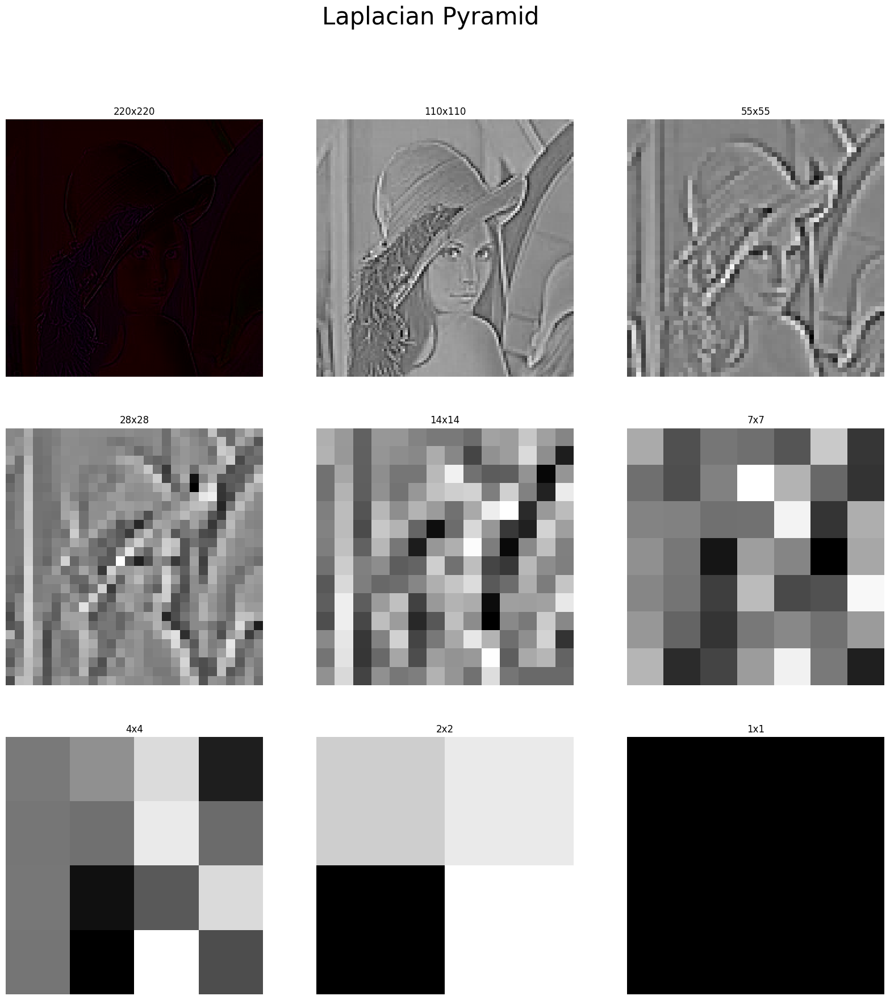

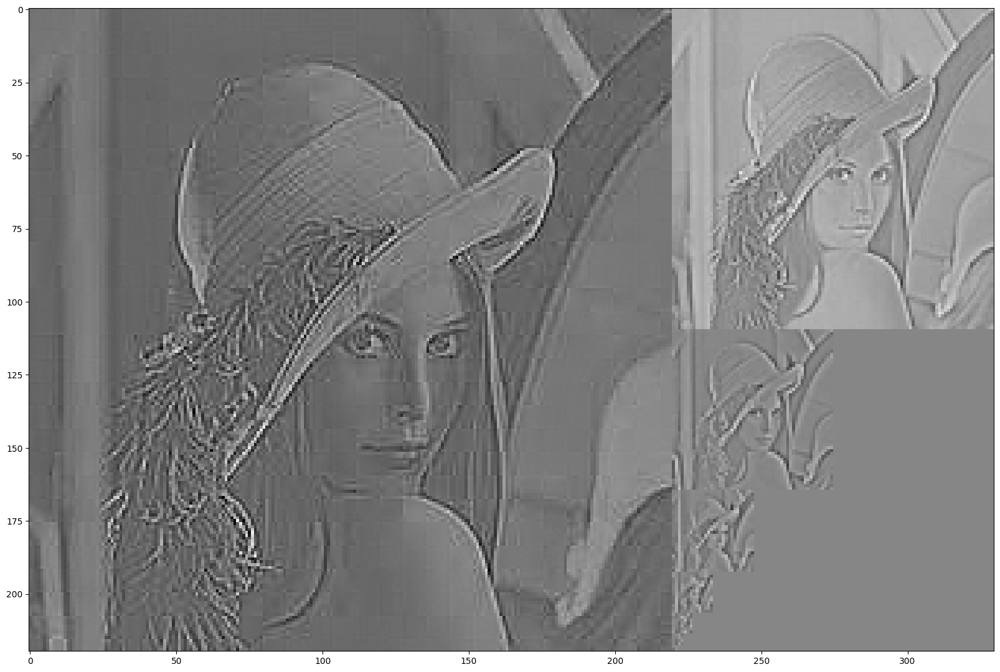

In [17]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import pyramid_laplacian
from skimage.color import rgb2gray

# Load the image
image = imread("images/lena.jpg")

# Function to convert a custom multi-channel image to grayscale
def custom_rgb2gray(img):
    # Extract the desired channels (you may need to adjust this)
    gray_image = img[..., 0]  # Assuming the first channel is the one to convert to grayscale
    return gray_image

nrows, ncols = image.shape[:2]
pyramid = tuple(pyramid_laplacian(image, downscale=2))

plt.figure(figsize=(20, 20))
i, n = 1, len(pyramid)
for p in pyramid:
    plt.subplot(3, 3, i)

    if p.shape[-1] == 3:
        plt.imshow(p, cmap='gray')  # Grayscale display
    else:
        # Convert the custom multi-channel image to grayscale
        gray_p = custom_rgb2gray(p)
        plt.imshow(gray_p, cmap='gray')

    plt.title(str(p.shape[0]) + 'x' + str(p.shape[1]))
    plt.axis('off')
    i += 1

plt.suptitle('Laplacian Pyramid', size=30)
plt.show()

composite_image = np.zeros((nrows, ncols + ncols // 2), dtype=np.double)

# Convert the first image in the pyramid to grayscale and assign it to composite_image
composite_image[:nrows, :ncols] = rgb2gray(pyramid[0])

i_row = 0
for p in pyramid[1:]:
    n_rows, n_cols = p.shape[:2]

    if p.shape[-1] == 3:
        # Convert the custom multi-channel image to grayscale
        gray_p = rgb2gray(p)
    else:
        # Convert the custom multi-channel image to grayscale
        gray_p = custom_rgb2gray(p)

    composite_image[i_row:i_row + n_rows, ncols:ncols + n_cols] = gray_p

    i_row += n_rows

fig, ax = plt.subplots(figsize=(20, 20))
ax.imshow(composite_image, cmap='gray')
plt.show()
